<h2><font color='darkblue'> Basic Exploration

<h4><font color='navy'> Libraries

In [29]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("whitegrid")
import cv2
from PIL import Image

import os
base_path = "../pest_classification/training_dataset/"
from tqdm import tqdm

<h4><font color='navy'> Loading data

In [11]:
train_data = pd.read_csv("../pest_classification/training_set.csv")
train_data.head(5)

,filename,label
0,Image_1.jpg,apoderus_javanicus
1,Image_2.jpg,apoderus_javanicus
2,Image_3.jpg,apoderus_javanicus
3,Image_4.jpg,apoderus_javanicus
4,Image_5.jpg,apoderus_javanicus


<h4><font color='navy'>Basic info

In [12]:
print("Number of images in train data: ", train_data.shape[0])

Number of images in train data:  310


Number of unique classes are:  16


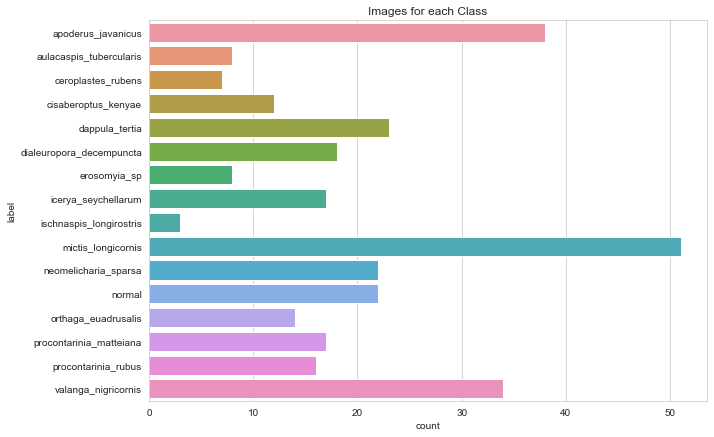

In [22]:
#checking the labels
print("Number of unique classes are: ", len(train_data.label.unique()))
plt.figure(figsize=(10,7))
sns.countplot(y=train_data['label'])
plt.title("Images for each Class")
plt.xticks([0, 10, 20, 30, 40, 50])
plt.show()

> The number of images is very less and we need to perform some augmentation to increase the data for each class

checking the shape of the images

In [26]:
##Getting size of images
list_of_heights = []
list_of_widths = []
for path in tqdm(train_data["filename"].values):
    img = cv2.imread(os.path.join(base_path, path),
                     cv2.IMREAD_UNCHANGED)
    # get dimensions of image
    shape = img.shape
    list_of_heights.append(shape[0])
    list_of_widths.append(shape[1])


100%|████████████████████████████████████████████████████████████████████████████████| 310/310 [00:04<00:00, 66.91it/s]


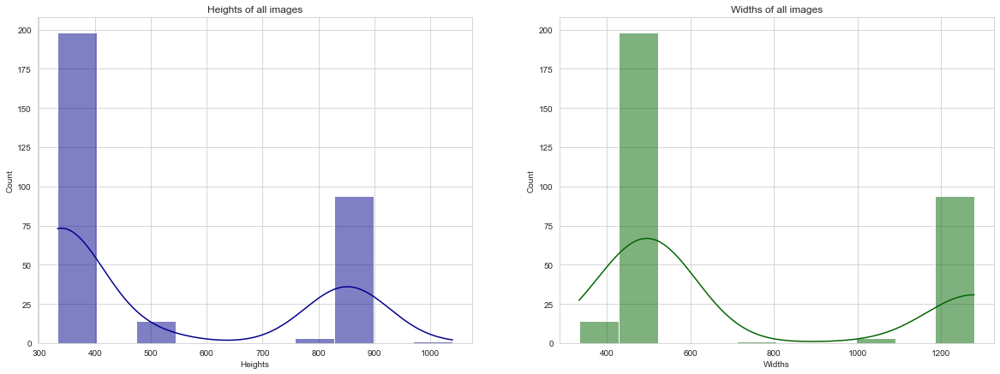

In [27]:
fig, ax = plt.subplots(1, 2, figsize=(20,7))

sns.histplot(ax=ax[0], x=list_of_heights, kde=True, color='darkblue')
ax[0].set_title("Heights of all images")
ax[0].set_xlabel("Heights")

sns.histplot(ax=ax[1], x=list_of_widths, kde=True, color='darkgreen')
ax[1].set_title("Widths of all images")
ax[1].set_xlabel("Widths")

plt.show()

In [28]:
print("Heights of the images are ranged from {} to {}".format(min(list_of_heights),
                                                              max(list_of_heights)))
print("Widths of the images are ranged from {} to {}".format(min(list_of_widths),
                                                              max(list_of_widths)))

Heights of the images are ranged from 333 to 1040
Widths of the images are ranged from 333 to 1280


Looking into few images for each class

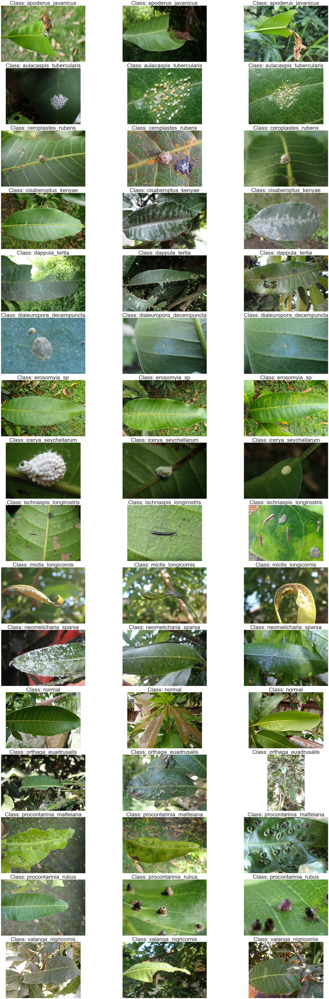

In [39]:
fig = plt.figure(figsize=(50, 100))
for num, category in enumerate(sorted(train_data['label'].unique())):
    for i, (idx, row) in enumerate(train_data.loc[train_data['label'] == category].sample(3).iterrows()):
        ax = fig.add_subplot(16, 4, num * 4 + i + 1, xticks=[], yticks=[])
        im = Image.open(os.path.join(base_path, row['filename']))
        plt.imshow(im)
        ax.set_title(f'Class: {category}', fontsize=40)
fig.tight_layout()
plt.show()

<h3><font color='navy'> Analysis on test set

In [40]:
test_data = pd.read_csv("../pest_classification/Testing_set.csv")
test_data.head()

,filename
0,Image_1.jpg
1,Image_2.jpg
2,Image_3.jpg
3,Image_4.jpg
4,Image_5.jpg


In [41]:
print("number of images in the test set are: ", test_data.shape[0])

number of images in the test set are:  13950
